# Tutorial 9: 10x Visium mouse brain data from Squidpy package

In this tutorial, we demonstrate how to enhance and denoise the gene expression patterns of mouse brain data using STGMVA. 

You can install Squidpy package and load this data via "adata = sq.datasets.visium_hne_adata()"

The original mouse brain is available at 10x Genomics website: https://support.10xgenomics.com/spatial-gene-expression/datasets/1.1.0/V1_Adult_Mouse_Brain 

This data has been manually annotated in the Squidpy package.


## Loading package

In [3]:
import os
import torch
import pandas as pd
import scanpy as sc
from sklearn import metrics
import multiprocessing as mp
import squidpy as sq
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from STGMVA.STGMVA import STGMMVE
from STGMVA import mk_dir

2023-07-15 14:20:09.973455: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## Reading ST data and showing the manual annotation

In [13]:
adata = sq.datasets.visium_hne_adata() # read data

/home/tengliu/miniconda3/envs/Torch_pyG2.0/lib/python3.9/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


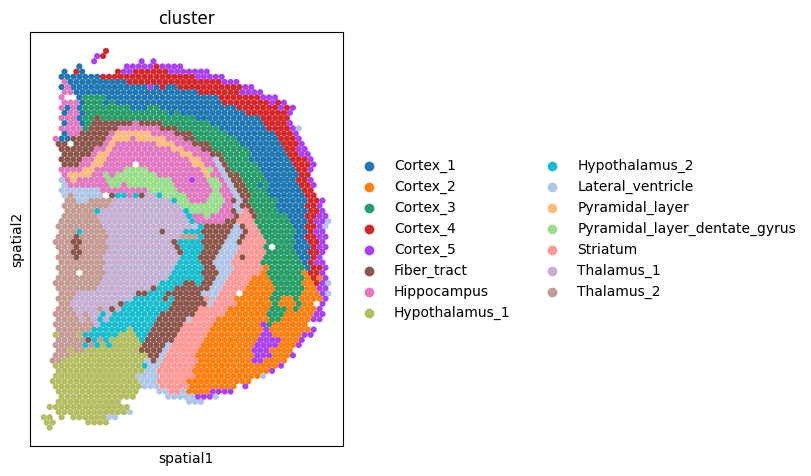

In [19]:
sq.pl.spatial_scatter(adata, color="cluster", size=40, figsize=(8,6),shape=None)

In [7]:
adata

AnnData object with n_obs × n_vars = 2688 × 18078
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

## Create directory for pretrained model

In [8]:
save_path='./Imputation_results/'
section_id = "mouse_brain"
mk_dir(save_path,section_id)

## Training the model

STGMVA aims to learn the representations by two-step process. First, pretrained the GMM clustering model. Second, discerned the spatial domains for spatial transcriptomics data. 

After model training, the learned representations will be saved in adata.obsm['embedding'], and can be used for spatial clustering. 

In [9]:
model = STGMMVE(adata, imputation=True,datatype = "Mouse", nCluster=15,save_path=save_path, section_id=section_id)

# model.pretrain() # Train your own pretranined model or use the pretrained model we provided.

adata_res = model.train_cluster()


/home/tengliu/miniconda3/envs/Torch_pyG2.0/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Graph constructed!


  0%|          | 0/50 [00:00<?, ?it/s]R[write to console]:                    __           __ 
   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 5.4.10
Type 'citation("mclust")' for citing this R package in publications.

  2%|▏         | 1/50 [00:06<05:17,  6.49s/it]

Epoch: 0
NMI=0.643384, ARI=0.461683
Loss=12.1072,  ELBO Loss=60.4636


 12%|█▏        | 6/50 [00:40<05:10,  7.06s/it]

Epoch: 5
NMI=0.627292, ARI=0.439771
Loss=12.9829,  ELBO Loss=36.5022


 22%|██▏       | 11/50 [01:16<04:20,  6.69s/it]

Epoch: 10
NMI=0.647456, ARI=0.473869
Loss=12.9240,  ELBO Loss=29.2507


 32%|███▏      | 16/50 [01:47<03:25,  6.03s/it]

Epoch: 15
NMI=0.647690, ARI=0.458287
Loss=12.7701,  ELBO Loss=26.6341


 42%|████▏     | 21/50 [02:20<03:08,  6.52s/it]

Epoch: 20
NMI=0.637479, ARI=0.444379
Loss=12.6324,  ELBO Loss=25.4331


 52%|█████▏    | 26/50 [02:49<02:18,  5.75s/it]

Epoch: 25
NMI=0.647323, ARI=0.468131
Loss=12.5578,  ELBO Loss=24.8886


 62%|██████▏   | 31/50 [03:22<02:08,  6.74s/it]

Epoch: 30
NMI=0.650110, ARI=0.478146
Loss=12.4956,  ELBO Loss=24.4925


 72%|███████▏  | 36/50 [03:51<01:22,  5.92s/it]

Epoch: 35
NMI=0.643957, ARI=0.475068
Loss=12.4747,  ELBO Loss=24.2227


 82%|████████▏ | 41/50 [04:23<00:57,  6.42s/it]

Epoch: 40
NMI=0.638198, ARI=0.449252
Loss=12.4180,  ELBO Loss=23.9077


 92%|█████████▏| 46/50 [04:49<00:21,  5.29s/it]

Epoch: 45
NMI=0.649857, ARI=0.488727
Loss=12.4057,  ELBO Loss=23.7013


100%|██████████| 50/50 [05:11<00:00,  6.23s/it]


In [10]:
adata_res

AnnData object with n_obs × n_vars = 2688 × 2688
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'cluster', 'pre_label'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap', 'log1p', 'ari_list', 'loss'
    obsm: 'X_pca', 'X_umap', 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'feat_mat', 'embedding'
    varm: 'PCs'
    layers: 'Recons_features'
    obsp: 'connectivi

## Visualization

We choose several marker genes to visualize the gene expression patterns in the spatial domain.

[<Axes: title={'center': 'STGMMVE_4732440D04Rik'}, xlabel='spatial1', ylabel='spatial2'>]

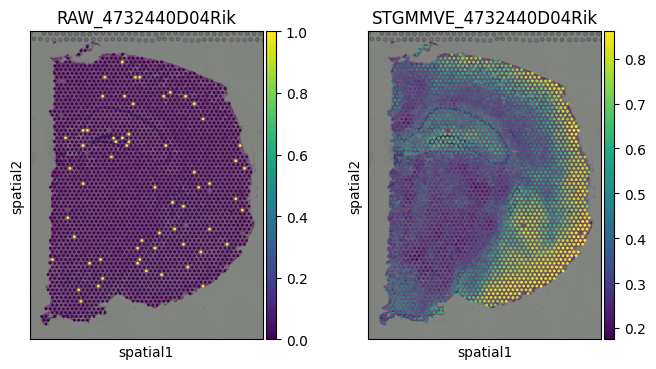

In [12]:
plot_gene = '4732440D04Rik'
fig, axs = plt.subplots(1, 2, figsize=(8, 4),dpi=100)
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[0], title='RAW_'+plot_gene, vmax='p99')
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[1], title='STGMMVE_'+plot_gene, layer='Recons_features', vmax='p99')

[<Axes: title={'center': 'STGMMVE_Eya1'}, xlabel='spatial1', ylabel='spatial2'>]

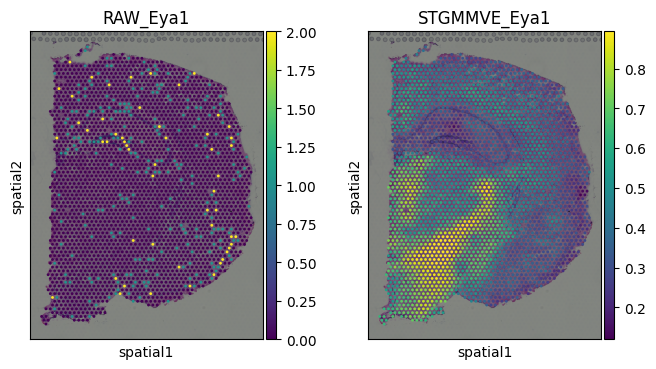

In [10]:
plot_gene = 'Eya1'
fig, axs = plt.subplots(1, 2, figsize=(8, 4),dpi=100)
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[0], title='RAW_'+plot_gene, vmax='p99')
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[1], title='STGMMVE_'+plot_gene, layer='Recons_features', vmax='p99')

[<Axes: title={'center': 'STGMMVE_Tfap2b'}, xlabel='spatial1', ylabel='spatial2'>]

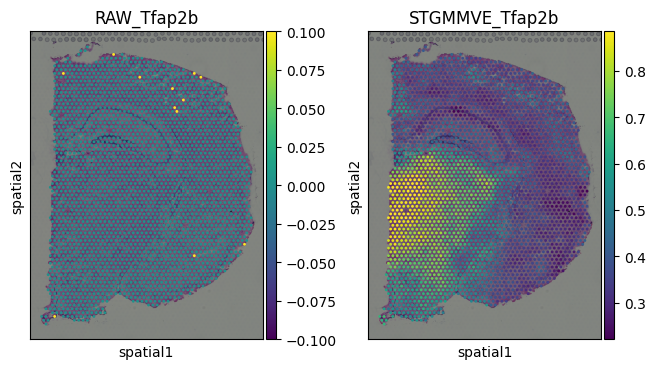

In [9]:
plot_gene = 'Tfap2b'
fig, axs = plt.subplots(1, 2, figsize=(8, 4),dpi=100)
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[0], title='RAW_'+plot_gene, vmax='p99')
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[1], title='STGMMVE_'+plot_gene, layer='Recons_features', vmax='p99')

[<Axes: title={'center': 'STGMMVE_Gm29107'}, xlabel='spatial1', ylabel='spatial2'>]

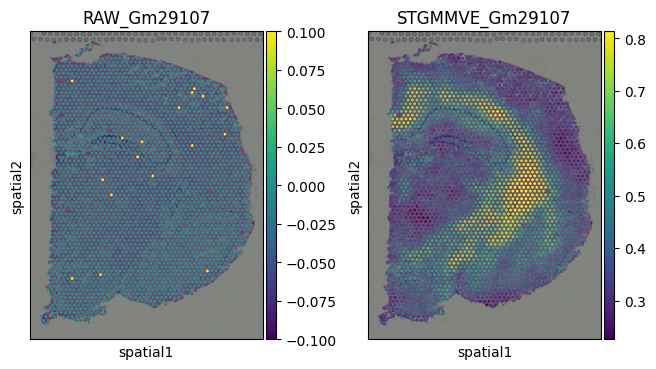

In [8]:
plot_gene = 'Gm29107'
fig, axs = plt.subplots(1, 2, figsize=(8, 4),dpi=100)
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[0], title='RAW_'+plot_gene, vmax='p99')
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[1], title='STGMMVE_'+plot_gene, layer='Recons_features', vmax='p99')

[<Axes: title={'center': 'STGMMVE_Col19a1'}, xlabel='spatial1', ylabel='spatial2'>]

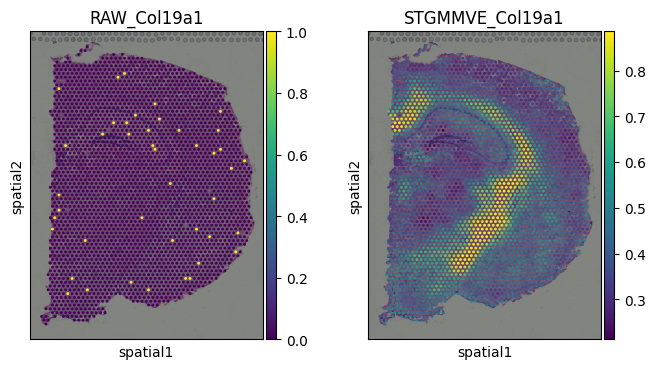

In [6]:
plot_gene = 'Col19a1'
fig, axs = plt.subplots(1, 2, figsize=(8, 4),dpi=100)
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[0], title='RAW_'+plot_gene, vmax='p99')
sc.pl.spatial(adata_res, img_key="hires", color=plot_gene, show=False, ax=axs[1], title='STGMMVE_'+plot_gene, layer='Recons_features', vmax='p99')

## Save the results for more figures

In [ ]:
adata_res.filename = './'+"mouse_brain_gene_imputation.h5ad"